# World happiness report - data analysis

Compare low income groups and high income groups 

__Goal of this project:__
* Understand what country-level metrics correlates with life ladder (i.e. the happiness) score from the World Happiness Report
* See what correlation exists independently from the country's income level classified by The World Bank. In other words, what can raise/lower happiness that can't be solved by money
* Attempt prediction of the life ladder based on data separate from world happiness report

__Main findings:__
* There is a clear pattern between life ladder and income group, where high income groups has better life ladder values
* Subjective metrics (e.g. social support, freedom to make life choices) have higher correlation for high income groups compared to low income groups. This can implicate as the country gets more rich (i.e. high income group), the subjective aspects of life matters more to life ladder score
* When looking only at high income countries, the top correlating metrics were related to income and GNI (Growth National Income). However, when looking at metrics adjusted by PPP (Purchasing power parity, cost of living in this context), the correlation gets much lower (lower than r-value of 0.5), which gets lower than most of the subjective metrics stated above
   * Also, personal health expenditure and government health expenditure has pretty high correlation (~0.67) even after PPP adjustment. 
* Young population percentage has different correlation between high income group (positive correlation) and others (negative correlation)

__Proposed next steps:__
* Do deeper analysis per age group, which is provided in 2023 world happiness report 
* Breakdown the health expenditure (personal and govenment) to understand if there are particular type of health expenditure that helps raise the life ladder value in the survey


## Documentation

### Hypothetical scenario for the analysis
An illustration of vague (but happens all the time) analysis scenario:

You are an analyst for a non-profit organization that works with a few western (mostly first world) countries as an outside consultant to advise on ways to increase citizen's happiness. Though it's a small organization, ability to provide objective opinion across countires (without political intervention) is deemed valuable. 

You are being tasked to do an analysis of the [World Happiness Report](https://happiness-report.s3.amazonaws.com/2024/WHR+24.pdf). Though the report provides valuable insights by itself, the clients something more tailored to their needs to take action. Here are a few opinions provided by the clients
* The report is not clear how much money plays a role in terms of happiness, especially in comparison with other subjective surveys (e.g. social support, positiveness). 
* If there are any particular insights for the first world countries.
* If there are any particular action items that government bodies can possibly take, based on the survey. 

You are tasked to provide a deeper analysis of the world happiness report by using its [raw data](https://worldhappiness.report/data/), but possibly utilizing other open data to come up with an analysis report for the clients that answers the questions stated above. 

### Approach

Here's the general analysis approach: 
* Find and import country-level statistical data/metrics that can be utilized for analysis. Main source is from The World Bank
* Join the World Happiness Report (WHP) data with external data to run correlation analysis (OLS) and regression analysis. Focus is to find if there are any other metrics that highly correlates with the happiness score (i.e. Life Ladder)
* Compare the result above with similar analysis done per income group (defined by The World Bank), to see if there are noticeable differences in correlation between income groups. 
* Do specific analysis for high income group to see if there are additional insights that can be pulled. 

_Note that the steps mentioned above is the initial approach, and the steps have changed in the actual research implementation below_

## Initialize

In [8]:
import pandas as pd
from itables import init_notebook_mode
from itables import show
import matplotlib.pyplot as plt
import seaborn as sns
import math
import numpy as np
from textwrap import wrap
import numpy.polynomial as poly

In [9]:
#Mapping dictionaries for renaming 
column_renames = {
    '2012 [YR2012]':'2012',
    '2013 [YR2013]':'2013',
    '2014 [YR2014]':'2014',
    '2015 [YR2015]':'2015',
    '2016 [YR2016]':'2016',
    '2017 [YR2017]':'2017',
    '2018 [YR2018]':'2018',
    '2019 [YR2019]':'2019',
    '2020 [YR2020]':'2020',
    '2021 [YR2021]':'2021',
    '2022 [YR2022]':'2022',
    '2023 [YR2023]':'2023',
    'Series Name': 'series',
    'Year': 'year',
    'Country Name': 'country',
    'Country name': 'country',
    'Country': 'country'
}    
country_renames = {
    'Congo, Rep.':'Congo (Brazzaville)',
    'Congo, Dem. Rep.':'Congo (Kinshasa)',
    'Egypt, Arab Rep.':'Egypt',
    'Gambia, The':'Gambia',
    'Hong Kong SAR, China':'Hong Kong S.A.R. of China',
    'Iran, Islamic Rep.':'Iran',
    'Côte d’Ivoire':'Ivory Coast',
    'Kyrgyz Republic':'Kyrgyzstan',
    'Lao PDR':'Laos',
    'Russian Federation':'Russia',
    'Slovak Republic':'Slovakia',
    'Somalia':'Somaliland region',
    'Korea, Rep.':'South Korea',
    'West Bank and Gaza':'State of Palestine', 
    'Syrian Arab Republic':'Syria',
    'Taiwan, China':'Taiwan Province of China',
    'Venezuela, RB':'Venezuela',
    'Yemen, Rep.':'Yemen',
}    

income_rename = {
    'H': 'High',
    'UM': 'U-mid',
    'LM': 'L-mid',
    'LM*': 'L-mid',
    'L': 'Low',
    '..':None
}

#Used for graphing and analysis
incomes = ['High','U-mid','L-mid','Low']

In [10]:
# Source data information
data_folder = 'data/'

world_happiness_file = 'world_happiness.csv'
wdi_1_file = 'WDI_data_1.csv'
wdi_2_file = 'WDI_data_2.csv'
nutrition_population_file = 'nutrition-population_Data.csv'
natural_disasters_file = 'natural-disasters.csv'
food_prices_file = 'food-prices_Data.csv'
ccdr_file = 'CCDR_Data.csv'
income_classification_file = 'WorldData_income_classify.csv' 
region_classification_file = 'WorldData_region_classify.csv' 

## Import & process source data
__General steps taken:__
* Import source csv files as dataframes
* Rename common column names for later merging
* Denormalize all dataframes 
* Merge all dataframes
* Create pivotted dataframe with countries in rows and metrics in columns

In [12]:
#Import into dataframes
world_happiness_df = pd.read_csv(data_folder +world_happiness_file)
wdi_1_df = pd.read_csv(data_folder +wdi_1_file)
wdi_2_df = pd.read_csv(data_folder +wdi_2_file)
nutrition_population_df = pd.read_csv(data_folder +nutrition_population_file)
natural_disasters_df = pd.read_csv(data_folder +natural_disasters_file)
food_prices_df = pd.read_csv(data_folder +food_prices_file)
ccdr_df = pd.read_csv(data_folder +ccdr_file)
income_classify_df = pd.read_csv(data_folder +income_classification_file)
region_classify_df = pd.read_csv(data_folder +region_classification_file)


In [13]:
#Column renaming and massaging (denormalizing). Steps are different for each source file

#World happiness 
world_happiness_df = world_happiness_df.rename(columns=column_renames).melt(id_vars=['country','year'],var_name='series',value_name='value')
world_happiness_df['source'] = 'World happiness'

#Natural disasters
natural_disasters_df = natural_disasters_df.rename(columns=column_renames).melt(id_vars=['country','year'],var_name='series',value_name='value')
natural_disasters_df['source'] = 'Natural disaster'

#World Development Indicators 1 + 2 then concat
if ('Country Code' in wdi_1_df.columns) and 'Series Code' in wdi_1_df.columns:
    wdi_1_df.drop(columns=['Series Code','Country Code'],inplace=True)
wdi_1_df = wdi_1_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')

if ('Country Code' in wdi_2_df.columns) and 'Series Code' in wdi_2_df.columns:
    wdi_2_df.drop(columns=['Series Code','Country Code'],inplace=True)
wdi_2_df = wdi_2_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')

wdi_df = pd.concat([wdi_1_df,wdi_2_df],axis=0)
wdi_df['source'] = 'WDI'



#Nutrition & populate data
if ('Country Code' in nutrition_population_df.columns) and 'Series Code' in nutrition_population_df.columns:
    nutrition_population_df.drop(columns=['Series Code','Country Code'],inplace=True)
nutrition_population_df = nutrition_population_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')
nutrition_population_df['source'] = 'Nutrition population'

#Food prices
if ('Country Code' in food_prices_df.columns) and 'Series Code' in food_prices_df.columns:
    food_prices_df.drop(columns=['Series Code','Country Code'],inplace=True)
if ('Classification Code' in food_prices_df.columns) and 'Classification Name' in food_prices_df.columns:
    food_prices_df.drop(columns=['Classification Code','Classification Name'],inplace=True)
food_prices_df = food_prices_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')
food_prices_df['source'] = 'Food prices'

#Country Climate and Development Reports 
if ('Country Code' in ccdr_df.columns) and 'Series Code' in ccdr_df.columns:
    ccdr_df.drop(columns=['Series Code','Country Code'],inplace=True)
ccdr_df = ccdr_df.rename(columns=column_renames).melt(id_vars=['country','series'],var_name='year',value_name='value')
ccdr_df['source'] = 'CCDR'

#Country classification data, includes income level and region
income_classify_df = income_classify_df.melt(id_vars=['Country'],var_name='year',value_name='Income group').rename(columns=column_renames)
income_classify_df['Income group'] = income_classify_df['Income group'].dropna().map(lambda x: income_rename[x])
income_classify_df['country'] = income_classify_df['country'].map(country_renames).fillna(income_classify_df['country'])
income_classify_df.dropna(inplace=True)
income_classify_df['year'] = pd.to_numeric(income_classify_df['year'])
#Country classification doesn't exist for 2023 yet. So, we will use the 2022 classifications 
income_classify_df_2023 = income_classify_df.loc[income_classify_df['year']==2022,['country','Income group']]
income_classify_df_2023['year'] = 2023
income_classify_df = pd.concat([income_classify_df,income_classify_df_2023],axis=0)

#Country region classification
region_classify_df.rename(columns=column_renames,inplace=True)
region_classify_df['country'] = region_classify_df['country'].map(country_renames).fillna(region_classify_df['country'])

In [14]:
#Merge all (except for country classification) into one dataframe as a denormalized dataframe
denorm_df = pd.concat(
    [world_happiness_df,
     natural_disasters_df,
     wdi_df,
     nutrition_population_df,
     food_prices_df,
     ccdr_df], axis=0)

#Clean up NaN data 
denorm_df = denorm_df.dropna()
denorm_df = denorm_df.loc[~denorm_df['country'].isna(),:]
denorm_df = denorm_df.loc[denorm_df['value'] != '..']
denorm_df = denorm_df.drop_duplicates()
#There are duplicate entries with different values coming from different data sources. There isn't a clear way to identify which 
#data source is correct. For now, using the 'first' data
denorm_df = denorm_df.drop_duplicates(subset=['country','year','series'],keep='first')

#Make value and year numeric
denorm_df['value'] =  pd.to_numeric(denorm_df['value'])
denorm_df['year'] =  pd.to_numeric(denorm_df['year'])

In [15]:
#Create pivotted dataframe. Rows are aggregated by country and year. Each column consists of metric
pivot_df = denorm_df.pivot_table(columns=['series'],index=['country','year'],values=['value'])
pivot_df.columns = [i[1] for i in pivot_df.columns]
pivot_df = pivot_df.dropna(subset=pivot_df.columns,how='all')
#Add country classification
pivot_df = pd.merge(pivot_df.reset_index(),income_classify_df,on=['country','year'],how='left')

#Add region classification
pivot_df = pd.merge(pivot_df,region_classify_df,on=['country'],how='left')

## Correlation analysis (total & per income group)
Quick note that outliers has not been taken out as they are (mostly) already aggregated numbers, and it makes more sense to also look at outliers together

### Data process before visualization
Create a Life Ladder (the main metric) correlation dataframe that includes correlation against all other metrics per income group + combined


In [18]:
#Generate correlation data for total, as well as separated by income group
corr_total_df = pivot_df.corr(numeric_only=True, min_periods = 30)
corr_income_dfs = []
for i in range(len(incomes)):
    corr_income_dfs.append(pivot_df.loc[pivot_df['Income group'] == incomes[i],:].corr(numeric_only=True))


In [19]:
#Create lifeladder (the main metric) dataframe that includes r-value against all metrics
lifeladder_df = pd.DataFrame(corr_total_df['Life Ladder'])
lifeladder_df.rename(columns={'Life Ladder':'Total corr'}, inplace=True)
#Remove correlation with itself
lifeladder_df = lifeladder_df.loc[lifeladder_df.index != 'Life Ladder']

#Add correlation value for each income group 
for df, income in zip(corr_income_dfs,incomes):    
    lifeladder_df = pd.merge(lifeladder_df,df['Life Ladder'],left_index=True,right_index=True,how='left')
    lifeladder_df.rename(columns={'Life Ladder': income + ' corr'}, inplace=True)

#Calculate # of pairwise datapoints used for each metric's correlation with life ladder, and add the counts into the lifeladder dataframe
lifeladder_count_df = pivot_df.loc[~pivot_df['Life Ladder'].isna()].groupby('Income group').count().transpose()
lifeladder_count_df.columns = [col + ' count' for col in lifeladder_count_df.columns]
lifeladder_count_df['Total count'] = lifeladder_count_df.sum(axis=1)
lifeladder_df = pd.merge(lifeladder_df,lifeladder_count_df,left_index=True,right_index=True,how='left')
lifeladder_df


,Total corr,High corr,U-mid corr,L-mid corr,Low corr,High count,L-mid count,Low count,U-mid count,Total count
year,0.046846,0.016919,-0.010857,-0.100288,-0.150286,732,627,388,608,2355
AIDS estimated deaths (UNAIDS estimates),-0.294490,0.052289,-0.149482,-0.312180,-0.148314,201,245,159,231,836
ARI treatment (% of children under 5 taken to a health provider),0.359740,NaN,0.482411,0.138255,-0.055142,1,42,37,20,100
Access to clean fuels and technologies for cooking (% of population),0.715679,0.059450,0.192384,0.351700,0.206156,244,170,98,180,692
"Access to clean fuels and technologies for cooking, rural (% of rural population)",0.715599,0.084316,0.187940,0.228165,0.272992,244,170,98,180,692
...,...,...,...,...,...,...,...,...,...,...
total_damages_pct_gdp_all_disasters_excluding_earthquakes,-0.036618,0.077800,0.045083,0.114102,0.059365,347,382,273,344,1346
total_damages_pct_gdp_all_disasters_excluding_extreme_temperature,-0.027638,0.018424,0.068919,0.121847,-0.012761,325,370,275,333,1303
total_damages_pct_gdp_glacial_lake_outburst_flood,NaN,NaN,NaN,NaN,NaN,0,1,0,0,1
total_damages_pct_gdp_wet_mass_movement,0.030919,0.322144,-0.012170,0.291413,-0.070576,14,72,46,40,172


In [20]:
# Initialization of parameters prior to graphing
cols_to_analyze=50
columns = 3
target_column = 'Life Ladder'

#Extract top N (defined by cols_to_analyze) positively correlated metrics
top_pos_corrs = lifeladder_df.sort_values(by='Total corr',ascending=False).head(cols_to_analyze)

#Extract top N (defined by cols_to_analyze) negatively correlated metrics
top_neg_corrs = lifeladder_df.sort_values(by='Total corr',ascending=True).head(cols_to_analyze)

#Extract bottom N (defined by cols_to_analyze) correlated metrics
weak_corrs = lifeladder_df.loc[lifeladder_df.abs().sort_values(by='Total corr',ascending=True).head(cols_to_analyze).index,:]


In [54]:
def graph_correlations(corr_df, source_df, 
                       graphs_per_row, max_graphs = 0, x_range = (1,8),
                       group_by = None, group_order = None,
                       show_linear_total = False, 
                       show_linear_groups = False, 
                       show_binomial_total = False, 
                       ):
    """
    Creates scatterplots with linear regression line based on provided data. 
    
    In: 
        corr_df (pd.DataFrame): Dataframe that includes all metrics to graph with the life ladder value. Should be a subset of lifeladder_df
        source_df (pd.DataFrame): Main dataframe that has all the datapoints. This should be pivot_df
        max_graphs (int): Maximum # of graphs to show. Default is all
        graphs_per_row (int): Decides how many graphs to include per row when plotting all the scatterplots
        x_range (int tuple): If set, specifies the range of x (life ladder) values to show on graph. Default is from 1 to 8
        group_by (string): If user provides a column name, then the plot will be grouped (colored) based on the column provided
        group_order (string): If user a list, then the group will be ordered by the group_order provided. 
        show_linear_total (bool): If true, show linear regression line(s) for the total
        show_binomial_total (bool): If true, show binomial regression line(s)
        show_linear_groups (bool): If true, show linear regression line(s) for the groups
    Out: 
        Scatterplots with regresison line, with additional regression line for each income group if user put True for show_income_groups
        Number of scatterplots depends on number of metrics (rows) included in corr_df
    """
    # set # of graphs 
    num_graphs = (len(corr_df) if (max_graphs == 0 or len(corr_df) < max_graphs) else max_graphs)
    fig, axes = plt.subplots(math.ceil(num_graphs/ graphs_per_row), graphs_per_row, figsize=(30,10 * math.ceil(num_graphs/graphs_per_row)))
    
    #If there is only one row in corr_df, then the "axes" is not an ndarray, which breaks the subsequent for loop to flatten the axes
    #Therefore, if it's one row then wrap it with a 2d ndarray
    if len(corr_df) ==1:
        axes = np.array([[axes]])
    if (group_by is not None) and (group_order is None):
        group_order = source_df[group_by].unique()
        
    
    for ax,corr_col in zip(axes.flatten(),corr_df.index[:num_graphs]):
        if (group_by is not None):
            sns.scatterplot(source_df,x=target_column,y=corr_col,hue=group_by, palette='tab10',hue_order=group_order, ax=ax)
        else:
            sns.scatterplot(source_df,x=target_column,y=corr_col,ax=ax)
        
        # Put # of data points and r-value to title
        n = corr_df.loc[corr_col,'Total count']
        r = round(corr_df.loc[corr_col,'Total corr'],4)
        ax.set_title("\n".join(wrap(f"{corr_col} (n={n}, r={r})", 50)),fontsize=20)
        ax.set_xlim(x_range[0],x_range[1]) # Highest world happiness score is less than 7, so limitting from 1 to 8
        ax.set_ylabel("")

        #Create temp dataframe for regression line calculation
        temp_df = source_df[['Income group',target_column,corr_col]].dropna()
        
        #Create a list of x values to be used when plotting regression lines
        plot_xs = np.arange(x_range[0],x_range[1]+0.1,0.2)
        
        
        #Linear Regression plotting for total
        if (show_linear_total):
            p = np.poly1d(np.polyfit(x=temp_df.loc[:,target_column],y=temp_df.loc[:,corr_col],deg=1))
            ax.plot(plot_xs, p(plot_xs),color='black',linewidth=2)

        # Binomial regression plotting for total
        if (show_binomial_total):
            p = np.poly1d(np.polyfit(x=temp_df.loc[:,target_column],y=temp_df.loc[:,corr_col],deg=2))
            ax.plot(plot_xs, p(plot_xs),color='black',linewidth=2, linestyle='dashed')

        
        
        if (group_by is not None):
            colors = sns.color_palette(n_colors=len(source_df[group_by].unique()))
            if group_order is None:
                group_order = source_df[group_by].unique()
            #Plot regression line for each income group (if data exists)
            for income, color in zip(group_order, colors):
                if (temp_df.loc[temp_df['Income group']==income,:].shape[0] > 0):                    
                    if (show_linear_groups):
                        p = np.poly1d(np.polyfit(x=temp_df.loc[temp_df['Income group']==income,target_column],
                                                 y=temp_df.loc[temp_df['Income group']==income,corr_col],deg=1))
                        ax.plot(plot_xs, p(plot_xs),color=color,linewidth=1)
                    
            if (show_linear_groups):
                    #Add # of data points and r-value into the legend
                h,l = ax.get_legend_handles_labels()
                for i,income in zip(range(len(l)),group_order):
                        n = corr_df.loc[corr_col,income+" count"]
                        r = round(corr_df.loc[corr_col,income+" corr"],3)
                        l[i] = f"{l[i]} (n={n}, r={r})"
                ax.legend(h,l, title = "Income Groups")
    


### Life ladder value by income group 
__Main outcome from this block:__
* There is a clear pattern between life ladder and income group, where high income groups has better life ladder values

<AxesSubplot: xlabel='Life Ladder', ylabel='Income group'>

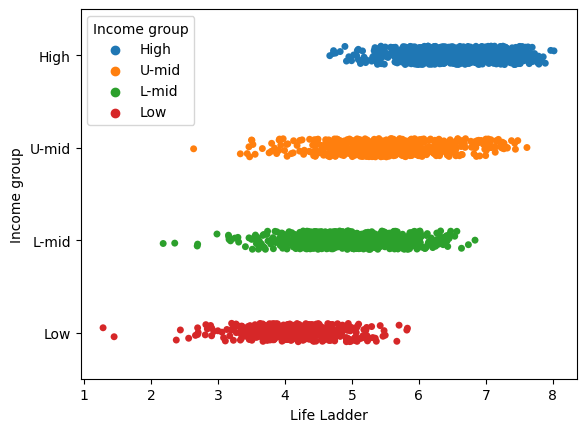

In [23]:
lifeladder_only_df = pivot_df.loc[:,['Life Ladder','Income group']].dropna()
lifeladder_only_df = lifeladder_only_df.sort_values('Life Ladder', ascending=False)

sns.stripplot(lifeladder_only_df, x='Life Ladder',y='Income group',hue_order=incomes, hue='Income group')

In [24]:
# Mean, median standard deviation per group 
lifeladder_only_df.pivot(columns='Income group',values='Life Ladder').describe().reindex(columns=incomes)

Income group,High,U-mid,L-mid,Low
count,732.000000,608.000000,627.000000,388.000000
mean,6.594828,5.545980,4.937373,4.176580
std,0.680122,0.789387,0.748184,0.657167
min,4.669000,2.634000,2.179000,1.281000
25%,6.111750,5.075750,4.429500,3.736500
50%,6.613500,5.514000,4.931000,4.222000
75%,7.158250,6.014250,5.462000,4.624500
max,8.019000,7.615000,6.839000,5.829000


In [25]:
show(pivot_df.loc[(pivot_df['Income group'] == 'Low') & (pivot_df['Life Ladder'] > 5)][['country','year','Life Ladder']])

### Correlation of WHP metrics per income group 

__Main outcome from this block__ 
* Subjective metrics (e.g. social support, freedom to make life choices) have higher correlation for high income groups compared to low income groups. This can implicate as the country gets more rich (i.e. high income group), the subjective aspects of life matters more to life ladder score. That being said, Log GDP per capita (objective, monetary metric) still has the igher correlation for high income group.

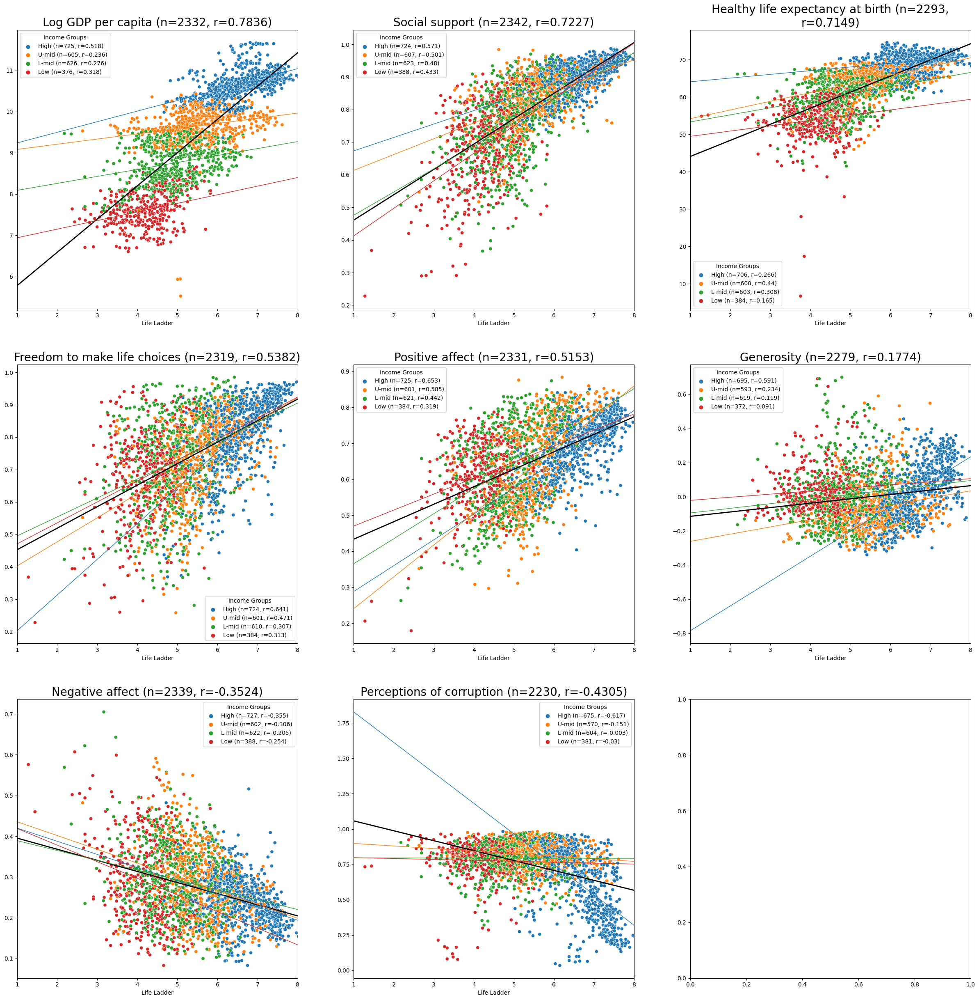

In [56]:
whp_metrics = denorm_df.loc[denorm_df['source'] == 'World happiness',:]['series'].unique()
whp_metrics
whp_df = lifeladder_df.loc[lifeladder_df.index.isin(whp_metrics),:].sort_values(by='Total corr', ascending = False)

graph_correlations(whp_df, pivot_df, columns, group_by = 'Income group', group_order = incomes, show_linear_total = True, show_linear_groups = True,x_range=(1,8))

### Top positively correlating metrics
In this section, few numbers are visually compared together

__Main outcome from this block:__
* Across the metrics, there is a discrepancy in correlation when looking at overall correlation VS per income group, where the r-value is always lower (at least 0.2) when looking at each income group. Moreover, for lower income groups, the r-value tends to be lower than high income groups. This phenomenon is likely explained by two reasons: 
   * High income groups' life ladder value seems to be driven more by monetary metrics
   * There are more data points for high income groups, therefore biasing the correlation towards higher income groups metrics
* The above observation indicates that for high correlation, it's better to look at correlations separately (for this dataset)
* HCI (Human capital index) has the highest correlation when looking at overall correlation. HCI index measures the amount of human capital that a child born today can expect to attain by age 18, including health and education. This high correlation makes sense because it is an aggregated metrics showing how much money is invested (or investable) to children across different aspects of life which leads to lesser chance of problems & issues that can lead to lower life ladder score. 
* In terms of WHP metrics, GDP per capita is higher (r=0.7876) than social support (r=0.7227) though both are stil highly correlated. But when looking at each income group, GDP per capita gets significantly lower correllation at lower income groups (0.518, 0.236, 0.272, 0.29 from high to low) when compared to social support which is consistely higher (0.571, 0.50, 0.48, 0.41 from high to low). 




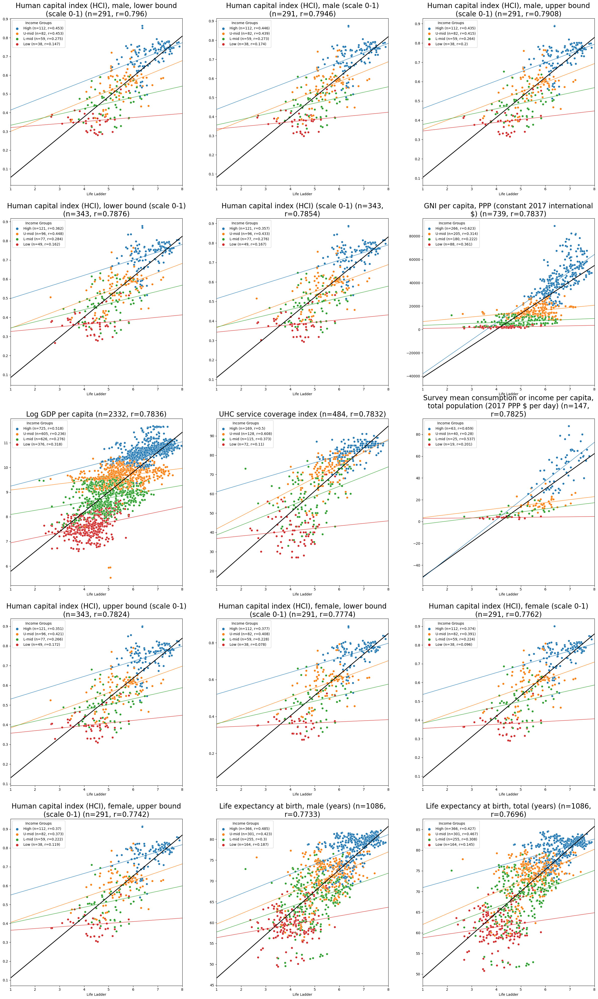

In [58]:

graph_correlations(top_pos_corrs, pivot_df, columns, max_graphs=15, group_by = 'Income group', group_order = incomes, show_linear_total = True, show_linear_groups = True)

### Top negatively correlating metrics
__Main outcome from this block:__
* Most of the highly negatively correlated metrics are related to health, poverty and  death
   * Cannot afford healthy diet (r=-0.76)
   * Poverty headcount ratio (r=-0.75) 
   * Still birth rate (r=-0.73)
* Young population percentage is interesting, because though weakly correlated per income group, the direction of the (linear) correlation is negative/zero for low (-0.12), l-mid (-0.13) and h-mid (-0.18) while it's positive for high income group (0.23)

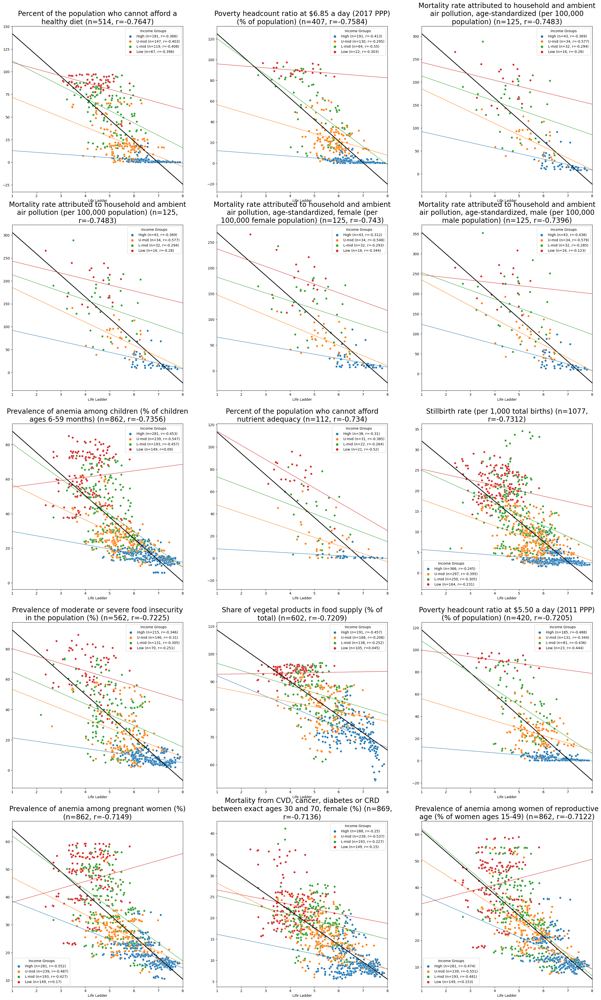

In [60]:
graph_correlations(top_neg_corrs, pivot_df, columns, max_graphs=15, group_by = 'Income group', group_order = incomes, show_linear_total = True, show_linear_groups = True)

### Bottom (weak) correlating metrics
__Main outcome from this block:__
* None for now

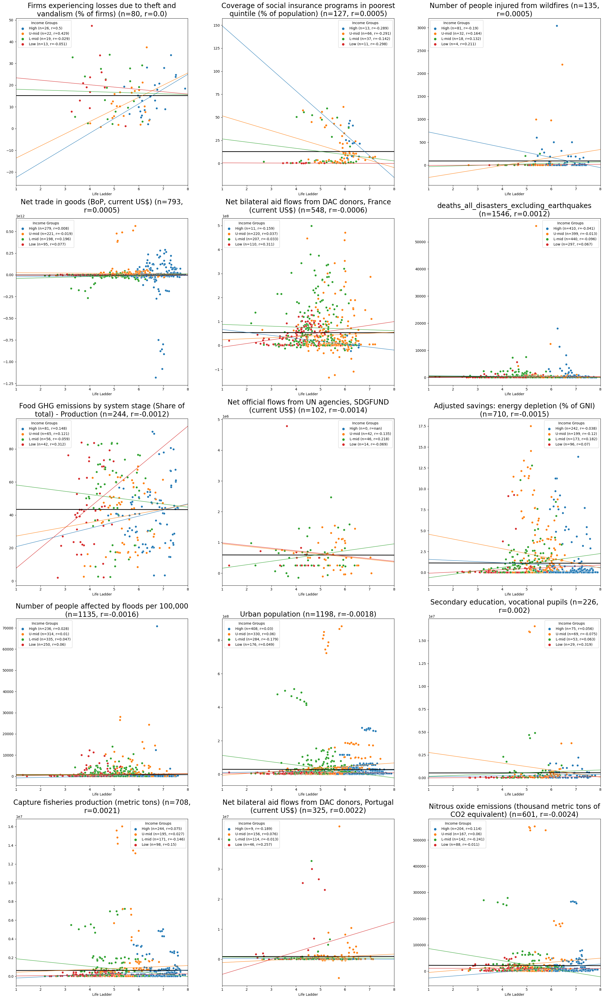

In [61]:
graph_correlations(weak_corrs, pivot_df, columns, max_graphs=15, group_by = 'Income group', group_order = incomes, show_linear_total = True, show_linear_groups = True)

### Top correlated metrics across income groups
__Main outcome from this block:__
* WHP's survey metrics covers majority of top correlating metrics when looking at average correlation across different income groups
   * Positive affect: mean(r)=0.5
   * Social support: mean(r)=0.5
   * Freedom to make life choices: mean(r) = 0.43
* Other metrics that came in were:
   * Adjusted net national income per capita (current US$): mean(r) = 0.46
   * Domestic general government health expenditure per capita (current US$): mean(r) = 0.43

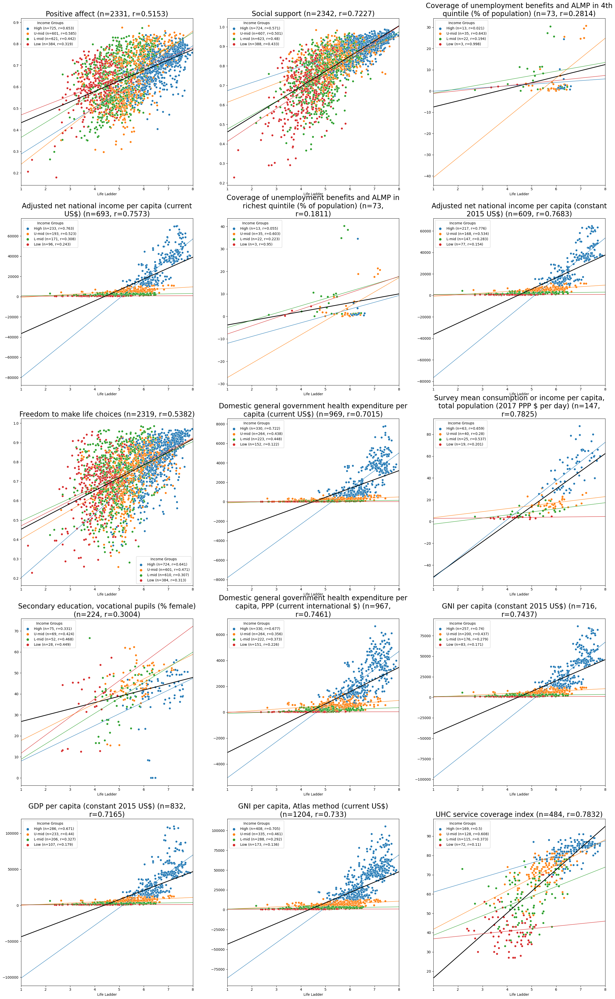

In [63]:
lifeladder_df['avg corr'] = lifeladder_df[[income + ' corr' for income in incomes]].mean(axis=1)

top_avg_pos_corrs = lifeladder_df.sort_values(by='avg corr',ascending=False).head(cols_to_analyze).dropna()
graph_correlations(top_avg_pos_corrs, pivot_df, columns, max_graphs=15, group_by = 'Income group', group_order = incomes, show_linear_total = True, show_linear_groups = True)

In [36]:
top_avg_pos_corrs.head(30)

,Total corr,High corr,U-mid corr,L-mid corr,Low corr,High count,L-mid count,Low count,U-mid count,Total count,avg corr
Positive affect,0.515283,0.653198,0.585107,0.442175,0.318555,725,621,384,601,2331,0.499759
Social support,0.722738,0.570541,0.501099,0.480004,0.432889,724,623,388,607,2342,0.496133
Coverage of unemployment benefits and ALMP in 4th quintile (% of population),0.281430,0.021240,0.643499,0.193525,0.998253,13,22,3,35,73,0.464129
Adjusted net national income per capita (current US$),0.757279,0.763374,0.523285,0.307670,0.242580,233,171,96,193,693,0.459227
Coverage of unemployment benefits and ALMP in richest quintile (% of population),0.181068,0.055470,0.603347,0.222595,0.949810,13,22,3,35,73,0.457805
Adjusted net national income per capita (constant 2015 US$),0.768319,0.775967,0.534222,0.282907,0.154054,217,147,77,168,609,0.436788
Freedom to make life choices,0.538210,0.640631,0.470882,0.306529,0.312801,724,610,384,601,2319,0.432711
Domestic general government health expenditure per capita (current US$),0.701546,0.721701,0.437895,0.447685,0.122208,330,223,152,264,969,0.432372
"Survey mean consumption or income per capita, total population (2017 PPP $ per day)",0.782476,0.659165,0.279736,0.536565,0.201194,63,25,19,40,147,0.419165
"Secondary education, vocational pupils (% female)",0.300431,0.331028,0.424362,0.467858,0.448829,75,52,28,69,224,0.418019


### Analysis only with high income 
__Main outcome from this block:__
* When looking only at high income countries, the top correlating metrics were related to income and GNI (Growth National Income), r-value more than 0.7. However, when looking at metrics adjusted by PPP (Purchasing power parity, cost of living in this context), the correlation gets much lower (lower than r-value of 0.5) 
* Interestingly, personal health expenditure and government health expenditure has pretty high correlation (~0.67) even after PPP adjustment. 
* Employment rate tends to have high correlation (r-value of 0.6~0.65) as well 
* In terms of WHP metrics, positive affects have higher correlation (r=0.65)  than social support (0.57)

In [66]:
high_pivot_df = pivot_df.loc[pivot_df['Income group'] == 'High',:]
high_lifeladder_df = high_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder']

high_lifeladder_df = pd.DataFrame(high_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder'])
high_lifeladder_df.rename(columns={'Life Ladder':'Total corr'}, inplace=True)
#Remove correlation with itself
high_lifeladder_df = high_lifeladder_df.loc[high_lifeladder_df.index != 'Life Ladder']

high_lifeladder_df.sort_values(by='Total corr', ascending=False)

#Calculate # of pairwise datapoints used for each metric's correlation with life ladder, and add the counts into the lifeladder dataframe
high_lifeladder_count_df = high_pivot_df.loc[~high_pivot_df['Life Ladder'].isna()].count().to_frame(name='Total count')
high_lifeladder_df = pd.merge(high_lifeladder_df,high_lifeladder_count_df,left_index=True,right_index=True)



In [68]:
#Extract top N (defined by cols_to_analyze) positively correlated metrics
high_top_pos_corrs = high_lifeladder_df.sort_values(by='Total corr',ascending=False).head(cols_to_analyze)

#Extract top N (defined by cols_to_analyze) negatively correlated metrics
high_top_neg_corrs = high_lifeladder_df.sort_values(by='Total corr',ascending=True).head(cols_to_analyze)

#Extract bottom N (defined by cols_to_analyze) correlated metrics
high_weak_corrs = high_lifeladder_df.loc[high_lifeladder_df.abs().sort_values(by='Total corr',ascending=True).head(cols_to_analyze).index,:]


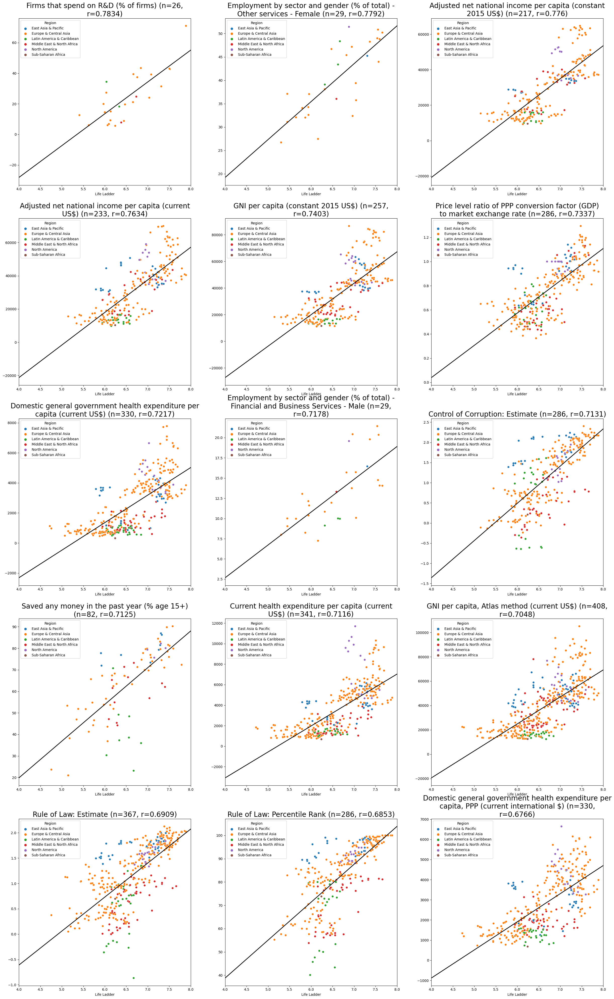

In [70]:
graph_correlations(high_top_pos_corrs, high_pivot_df, max_graphs=15, graphs_per_row=3, group_by = 'Region', show_linear_total = True, x_range=(4,8))


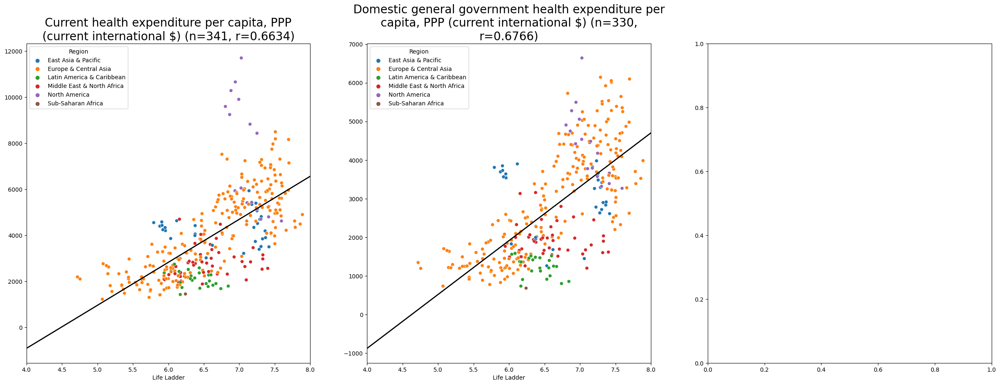

In [71]:
graph_correlations(high_lifeladder_df[high_lifeladder_df.index.isin(
    ['Current health expenditure per capita, PPP (current international $)',
'Domestic general government health expenditure per capita, PPP (current international $)'])], 
    high_pivot_df, max_graphs=15, graphs_per_row=3, group_by = 'Region', show_linear_total = True, x_range=(4,8))


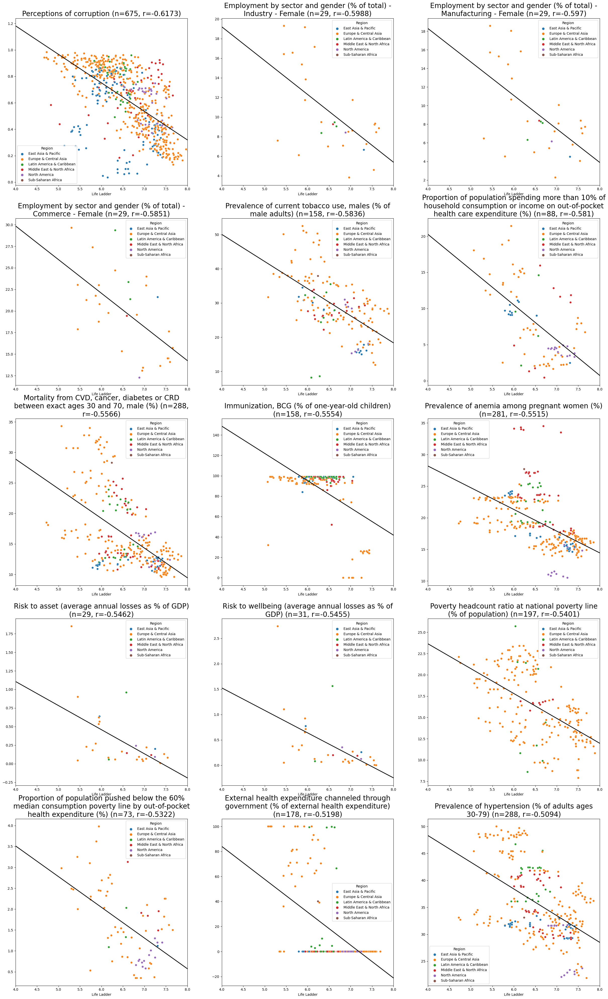

In [72]:
graph_correlations(high_top_neg_corrs, high_pivot_df, max_graphs=15, graphs_per_row=3, group_by = 'Region', show_linear_total = True, x_range=(4,8))


### Analysis only with low income 
__Main outcome from this block:__
* Inconclusive (for now). The amount of data point is somewhat smaller and correlations were low. Will need longer deepdive if looking for meaningful insights

In [73]:
low_pivot_df = pivot_df.loc[pivot_df['Income group'] == 'Low',:]
low_lifeladder_df = low_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder']

low_lifeladder_df = pd.DataFrame(low_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder'])
low_lifeladder_df.rename(columns={'Life Ladder':'Total corr'}, inplace=True)
#Remove correlation with itself
low_lifeladder_df = low_lifeladder_df.loc[low_lifeladder_df.index != 'Life Ladder']

low_lifeladder_df.sort_values(by='Total corr', ascending=False)

#Calculate # of pairwise datapoints used for each metric's correlation with life ladder, and add the counts into the lifeladder dataframe
low_lifeladder_count_df = low_pivot_df.loc[~low_pivot_df['Life Ladder'].isna()].count().to_frame(name='Total count')
low_lifeladder_df = pd.merge(low_lifeladder_df,high_lifeladder_count_df,left_index=True,right_index=True)



In [77]:
#Extract top N (defined by cols_to_analyze) positively correlated metrics
low_top_pos_corrs = low_lifeladder_df.sort_values(by='Total corr',ascending=False).head(cols_to_analyze)

#Extract top N (defined by cols_to_analyze) negatively correlated metrics
low_top_neg_corrs = low_lifeladder_df.sort_values(by='Total corr',ascending=True).head(cols_to_analyze)

#Extract bottom N (defined by cols_to_analyze) correlated metrics
low_weak_corrs = low_lifeladder_df.loc[low_lifeladder_df.abs().sort_values(by='Total corr',ascending=True).head(cols_to_analyze).index,:]


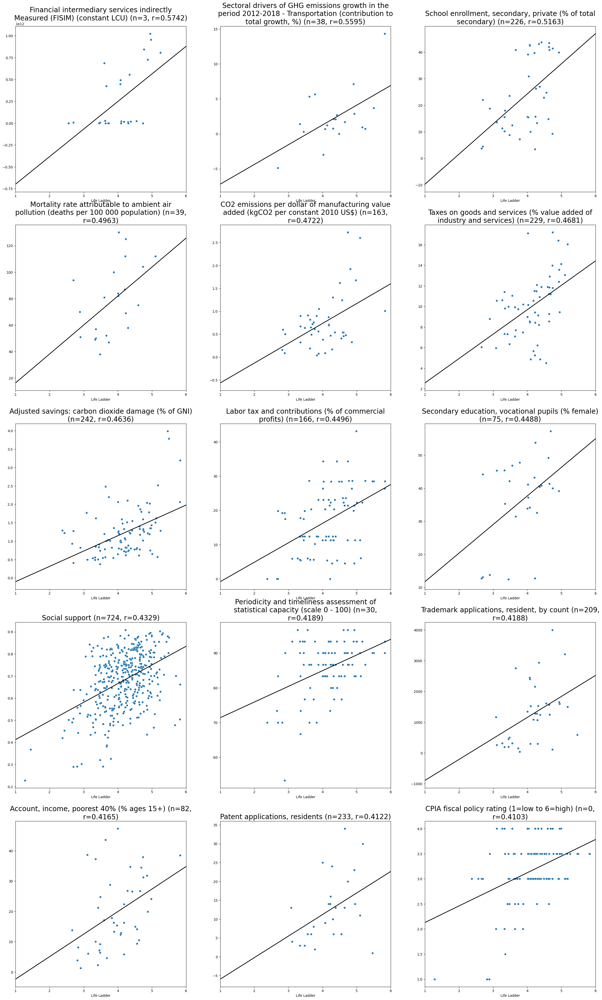

In [82]:
graph_correlations(low_top_pos_corrs, low_pivot_df, columns, max_graphs=15, show_linear_total = True, x_range=(1,6))


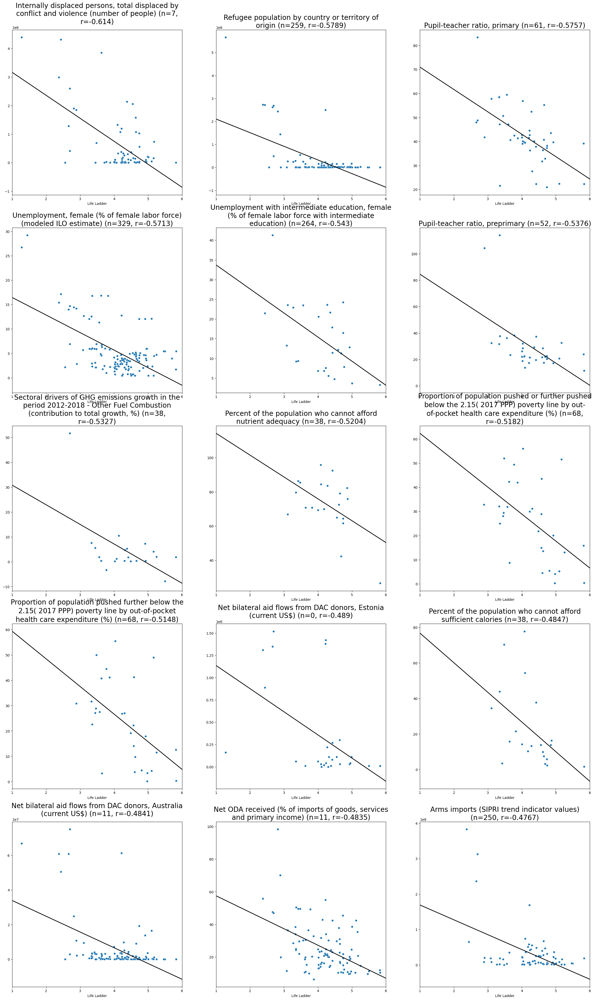

In [84]:
graph_correlations(low_top_neg_corrs, low_pivot_df, columns, max_graphs=15, show_linear_total = True, x_range=(1,6))


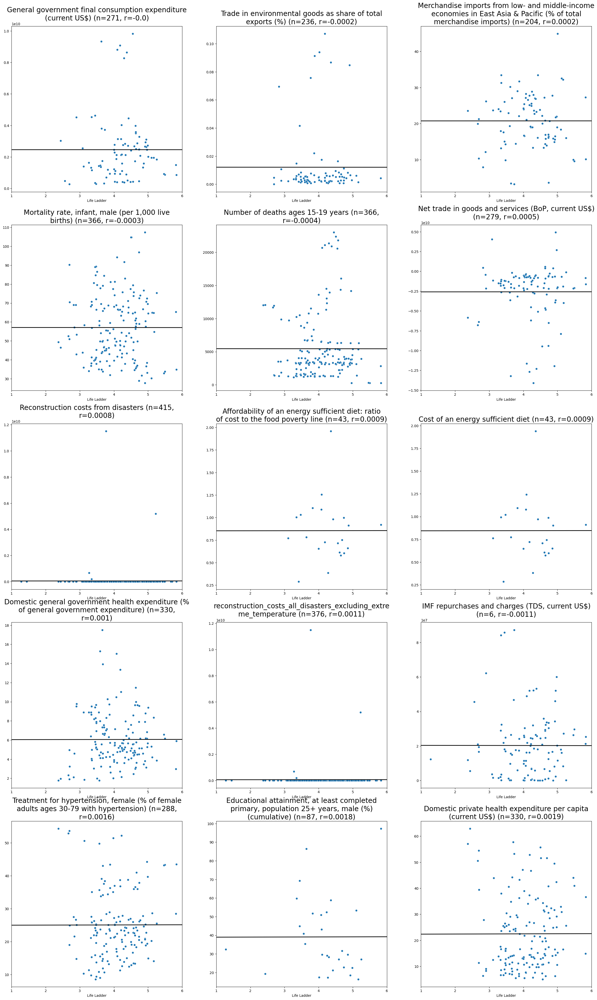

In [85]:
graph_correlations(low_weak_corrs, low_pivot_df, columns, max_graphs=15, show_linear_total = True, x_range=(1,6))


### Analysis with OECD data
OECD data also has some metrics similar to WHP (e.g. life satisfaction). Doing extra analysis to see if there are additional insights. 

__Main outcome from this block:__
* Life satisfaction (another subjective survey by OECD) has very high correlation with life ladder. 
* Other metrics' correlation remains mostly the same as high income correlation analysis
   * Average gross earnings (0.73)
   * Employment rate (0.66)

#### Data setup
OECD data can be pulled via API. We will use pandasdmx + custom setup to pull data

In [96]:
import pandasdmx as sdmx
# Create new data source for pandasdmx, as OECD has a new API endpoint
NEW_OECD = {
  "id": "OECD.WISE.WDP",
  "documentation": "https://gitlab.algobank.oecd.org/public-documentation/dotstat-migration/-/raw/main/OECD_Data_API_documentation.pdf",
  "url": "https://sdmx.oecd.org/public/rest",
  "name": "OECD new",
  "supported": {"dataflow": True}
}

sdmx.add_source(NEW_OECD,override=True)

C:\Users\hiron\AppData\Roaming\Python\Python311\site-packages\pandasdmx\remote.py:11: RuntimeWarning: optional dependency requests_cache is not installed; cache options to Session() have no effect
  warn(


In [97]:
#PARAMETERS

# Year range to fetc the values from
OECD_years_from = 2016
OECD_years_to = 2022


In [98]:
#API initialize
resource_id = 'DSD_HSL@DF_HSL_CWB'
key='all'
oecd = sdmx.Request('OECD.WISE.WDP')
# Fetch data from OECD API for the years specified and store them to oecd_df
oecd_df_orig = None
for year in range(OECD_years_from, OECD_years_to+1):
    result = oecd.get(resource_type='data',resource_id=resource_id,key=key,params={'startPeriod':year, 'endPeriod':year})
    if oecd_df_orig is None:
        oecd_df_orig = result.to_pandas()
    else: 
        oecd_df_orig = pd.concat([oecd_df_orig, result.to_pandas()],axis=0)

#oecd_df is actually a series at this point. Convert to an actual dataframe
oecd_df_orig = pd.DataFrame(oecd_df_orig).reset_index()

In [99]:
#additionally, get code list from their API to map the code ID/values to meaningful names
result = oecd.get(resource_type='dataflow',resource_id=resource_id,version='1.0',params={'references': 'codelist'})

code_dict = sdmx.to_pandas(result)

#code_dict is actually a dictionary of dictionaries, so make it flat
column_map = {
    'SEX':'CL_SEX',
    'REF_AREA':'CL_REGIONAL',
    'MEASURE':'CL_MEASURE',
    'UNIT_MEASURE':'CL_UNIT_MEASURE',
    'AGE':'CL_AGE',
    'EDUCATION_LEV':'CL_EDUCATION_LEV_ISCED11',
    'DOMAIN':'CL_DOMAIN',
}
name_map_df = pd.DataFrame(columns=['type','key','name','parent'])

for key, value in code_dict.codelist.items():
#note that 'value' is actually a dictionary
    value['type'] = key
    value = value.reset_index().rename(columns={key:'key'})
    name_map_df = pd.concat([name_map_df,value],axis=0)


In [100]:
#Keep the original OECD dataframe as is, and create new one with mapped values

oecd_df = oecd_df_orig.copy()
for key, value in column_map.items():
    map_df = name_map_df.loc[name_map_df['type']==value,['key','name']]
    oecd_df = oecd_df.merge(map_df,left_on=key,right_on='key',how='left')
    oecd_df.loc[:,key] = oecd_df.loc[:,'name']
    oecd_df.drop('key',axis=1,inplace=True)
    oecd_df.drop('name',axis=1,inplace=True)
    
#For this analysis, we will only use the total, so we are removing others, and also renaming columns
oecd_df = oecd_df.loc[(oecd_df['AGE'] == 'Total') & 
                      (oecd_df['SEX'] == 'Total') & 
                      (oecd_df['EDUCATION_LEV'] == 'Total')
                      ,['REF_AREA','MEASURE','TIME_PERIOD','value']]
oecd_df.rename(columns={'REF_AREA':'country', 'MEASURE':'series','TIME_PERIOD':'year'},inplace=True)
oecd_df['source']='OECD'
oecd_df['year'] = pd.to_numeric(oecd_df['year'])

#OECD document uses "Korea" for South Korea. Renaming
oecd_df.loc[oecd_df['country']=='Korea','country'] = 'South Korea'

In [101]:
#Create a pivot table and add life ladder to the mix
oecd_pivot_df = oecd_df.pivot_table(columns=['series'],index=['country','year'],values=['value'])
oecd_pivot_df.columns = [i[1] for i in oecd_pivot_df.columns]
oecd_pivot_df = oecd_pivot_df.reset_index()
#pivot_df = pivot_df.dropna(subset=pivot_df.columns,how='all')
#Add country classification


oecd_pivot_df = pd.merge(oecd_pivot_df,pivot_df[['country','year','Life Ladder','Income group']],on=['country','year'],how='left')


#### Analysis

In [108]:
##Income group included in the data
oecd_pivot_df[['country','Income group']].drop_duplicates()['Income group'].value_counts()

High     33
U-mid     6
Name: Income group, dtype: int64

In [109]:
#Create correlation dataframe using Life Ladder data

oecd_lifeladder_df = pd.DataFrame(oecd_pivot_df.corr(numeric_only = True,min_periods=20)['Life Ladder'])
oecd_lifeladder_df.rename(columns={'Life Ladder':'Total corr'}, inplace=True)
#Remove correlation with itself
oecd_lifeladder_df = oecd_lifeladder_df.loc[oecd_lifeladder_df.index != 'Life Ladder']

oecd_lifeladder_df.sort_values(by='Total corr', ascending=False)

#Calculate # of pairwise datapoints used for each metric's correlation with life ladder, and add the counts into the lifeladder dataframe
oecd_lifeladder_count_df = oecd_pivot_df.loc[~oecd_pivot_df['Life Ladder'].isna()].count().to_frame(name='Total count')
oecd_lifeladder_df = pd.merge(oecd_lifeladder_df,oecd_lifeladder_count_df,left_index=True,right_index=True)


In [110]:
oecd_lifeladder_df.sort_values(by='Total corr',ascending=False)

,Total corr,Total count
Life satisfaction,0.686634,111
Average annual gross earnings,0.677284,250
Social support,0.657086,268
Employment rate,0.640702,267
Households and NPISHs net adjusted disposable income per capita,0.632914,214
...,...,...
Long unpaid working hours,NaN,4
Time off,NaN,10
Time spent in social interactions,NaN,6
Top adult literacy scores decile,NaN,4


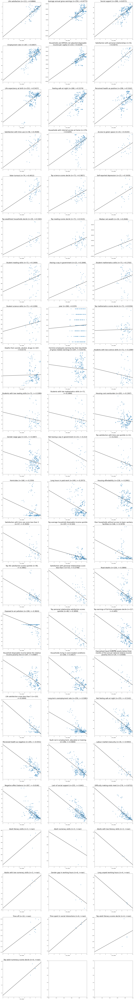

In [111]:
graph_correlations(oecd_lifeladder_df.sort_values(by='Total corr',ascending=False), oecd_pivot_df, columns, show_linear_total = True)

In [112]:
lifeladder_country_df = lifeladder_df.copy()
countries = pivot_df.loc[~pivot_df['Life Ladder'].isna(),'country'].unique()

#Calculate correlation per country
corr_country_dfs = []
for i in range(len(countries)):
    corr_country_dfs.append(pivot_df.loc[pivot_df['country'] == countries[i],:].corr(min_periods=5,numeric_only=True))

for df, country in zip(corr_country_dfs,countries):    
    lifeladder_country_df = pd.merge(lifeladder_country_df,df['Life Ladder'],left_index=True,right_index=True,how='left')
    lifeladder_country_df.rename(columns={'Life Ladder': country}, inplace=True)



In [113]:
avg_corr_df = lifeladder_country_df.iloc[:,10:].mean(axis=1).sort_values(ascending=False).to_frame(name='avg corr')
avg_corr_df = pd.merge(avg_corr_df,lifeladder_country_df.iloc[:,10:].count(axis=1).to_frame(name='corr count'),left_index=True, right_index=True)
avg_corr_df = pd.merge(avg_corr_df,lifeladder_country_df.iloc[:,10:].std(axis=1).to_frame(name='corr std'),left_index=True, right_index=True)

avg_corr_df

,avg corr,corr count,corr std
Operating coal power capacity by plant type (MW) - Plant Type (IGCC),1.0,1,NaN
affected_rate_per_100k_glacial_lake_outburst_flood,1.0,1,NaN
affected_glacial_lake_outburst_flood,1.0,1,NaN
total_affected_rate_per_100k_glacial_lake_outburst_flood,1.0,1,NaN
total_affected_glacial_lake_outburst_flood,1.0,1,NaN
...,...,...,...
homeless_rate_per_100k_glacial_lake_outburst_flood,NaN,0,NaN
insured_damages_glacial_lake_outburst_flood,NaN,0,NaN
reconstruction_costs_glacial_lake_outburst_flood,NaN,0,NaN
reconstruction_costs_wet_mass_movement,NaN,0,NaN


In [114]:
show(lifeladder_country_df[lifeladder_country_df.index=='Positive affect'].transpose())

## Misc

In [ ]:

from sklearn.cluster import KMeans


temp_df = high_pivot_df[['country','year','Life Ladder','Current health expenditure per capita (current US$)']].dropna()
k = 2

kmeans = KMeans(n_clusters=k)

# Fit the model to the data (training)
kmeans.fit(temp_df[['Life Ladder','Current health expenditure per capita (current US$)']])

# Get the cluster labels for each data point
cluster_labels = kmeans.labels_

# # Create a scatter plot with colors based on cluster labels
# plt.scatter(temp_df['Life Ladder'], temp_df['Current health expenditure per capita (current US$)'], c=cluster_labels)

# # Add labels and title
# plt.xlabel('Life Ladder')
# plt.ylabel('Current health expenditure per capita (current US$)')
# plt.title('K-Means Clustering (2 Clusters)')

# Show the plot
temp_df['cluster'] = cluster_labels

sns.scatterplot(temp_df,x='Life Ladder',y='Current health expenditure per capita (current US$)',hue='country',style='cluster')

In [ ]:
denorm_df.loc[denorm_df['series'].str.contains('Population'),'series'].unique()
# # create grouped boxplot  
# sns.boxplot(x = data['day'], 
#             y = data['total_bill'], 
#             hue = data['sex'])

### (Stretch) Correlation analysis per country
Analysis per country has been attempted. However, there aren't enough datapoints to prove something conclusive